In [1]:
import arviz as az
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pymc as pm
import pytensor
import pytensor.tensor as pt
import math

from numba import njit
from pymc.ode import DifferentialEquation
from pytensor.compile.ops import as_op
from scipy.integrate import odeint
from scipy.optimize import least_squares
from scipy.optimize import leastsq

from sklearn import linear_model
from numpy.linalg import norm

from scipy.stats import friedmanchisquare
from scipy.stats import wilcoxon
from statsmodels.stats.multitest import multipletests

import warnings
warnings.filterwarnings('ignore')

WARNING (pytensor.configdefaults): g++ not available, if using conda: `conda install m2w64-toolchain`
WARNING (pytensor.configdefaults): g++ not detected!  PyTensor will be unable to compile C-implementations and will default to Python. Performance may be severely degraded. To remove this warning, set PyTensor flags cxx to an empty string.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


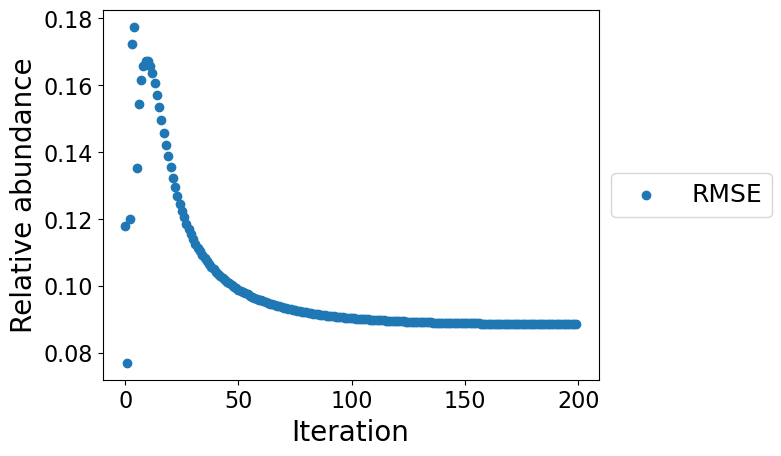

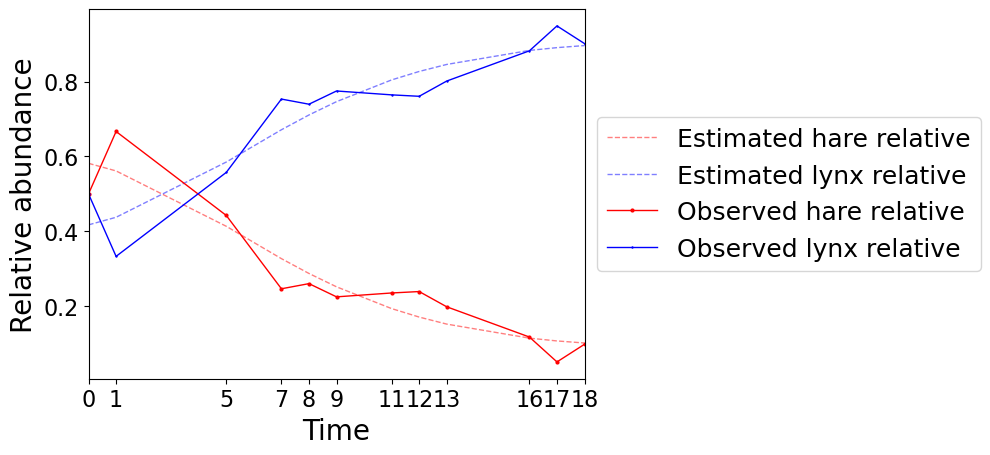

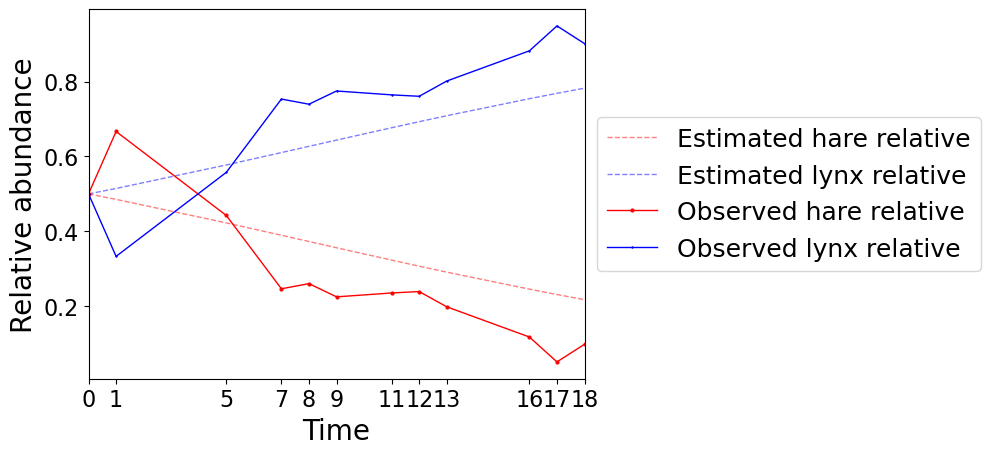

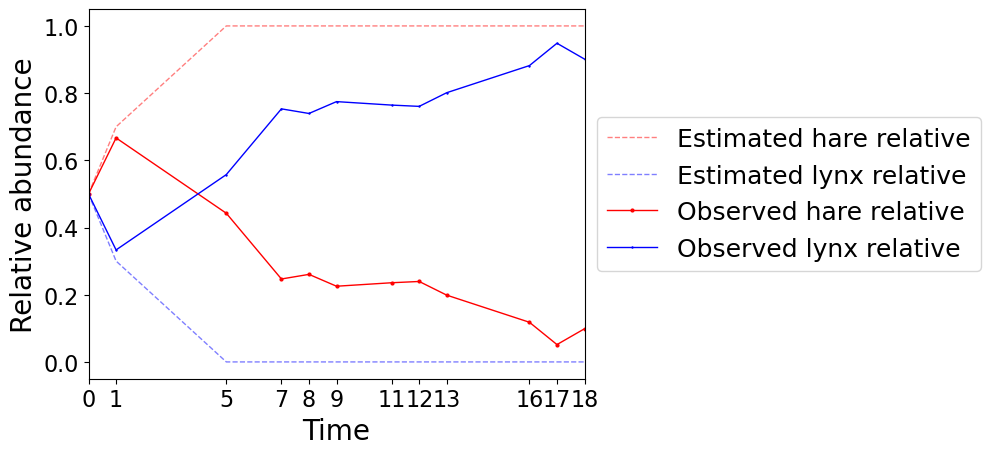

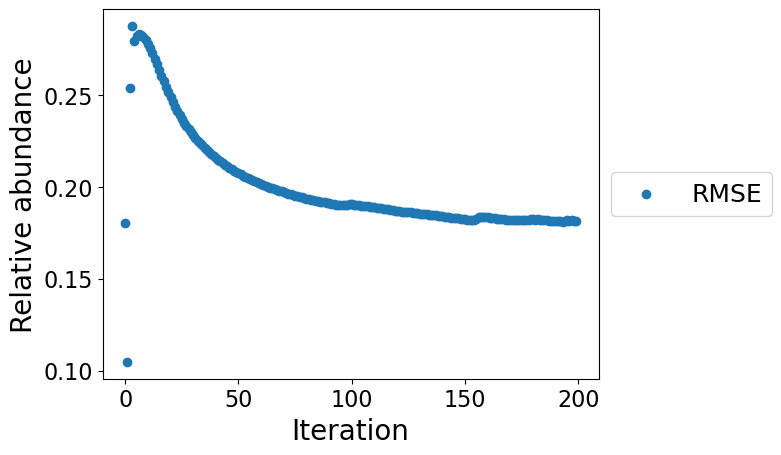

...

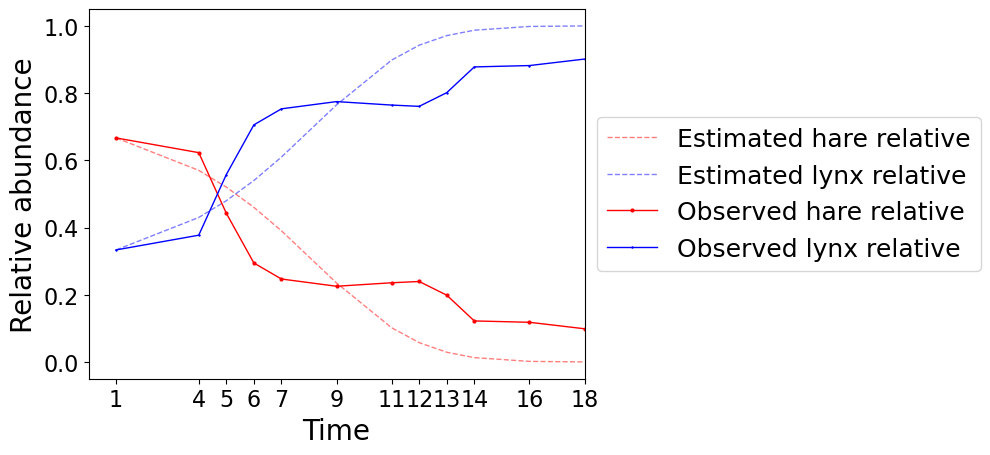

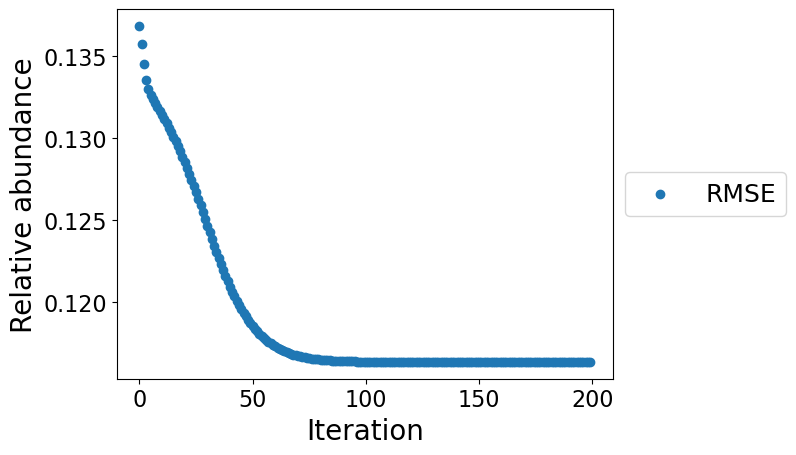

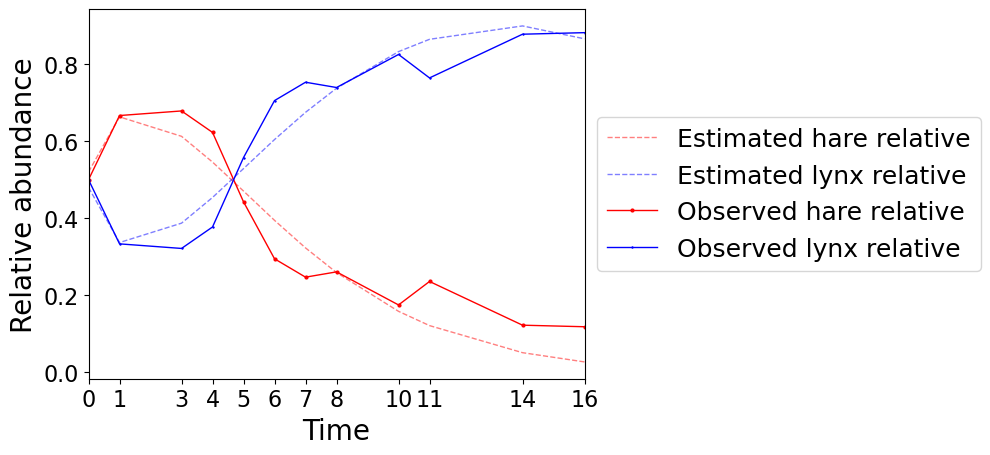

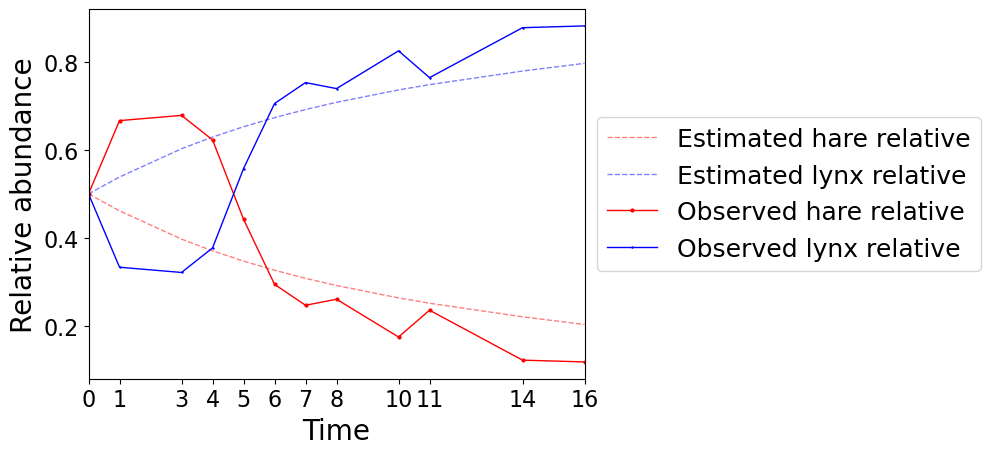

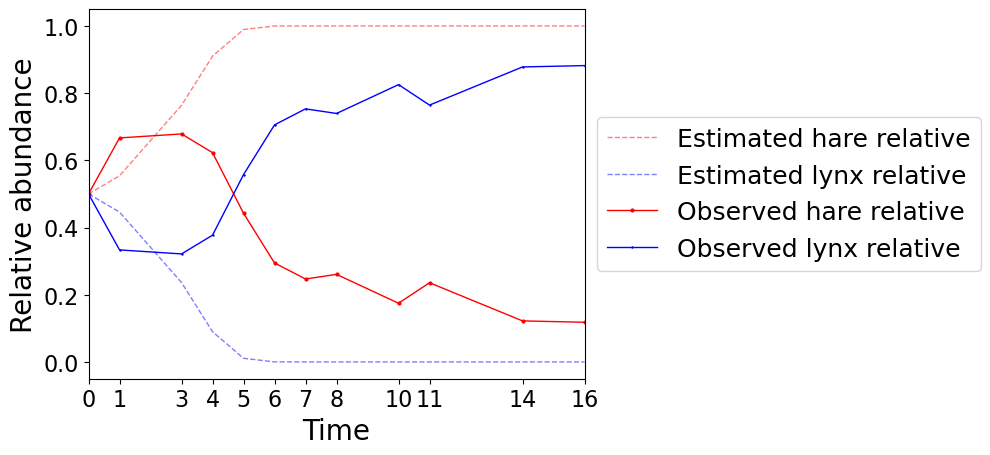

In [2]:
df_full = pd.read_csv('../Data/coculture.csv')

num_round = 100
method_used = ["None"]*num_round
distance_ilv = [np.inf]*num_round
distance_glvr = [np.inf]*num_round
distance_glva = [np.inf]*num_round
distance_ilv_val = [np.inf]*num_round
distance_glvr_val = [np.inf]*num_round
distance_glva_val = [np.inf]*num_round
used_seeds = set()
seed = 1

for rep in range(num_round):
    success = False
    while not success:
        try:
            np.random.seed(seed)
            time_seg = 1
            cur_time_full = np.arange(0, len(df_full), time_seg)
            indices = np.random.choice(len(cur_time_full), size=7, replace=False)
            # Split the array
            mask = np.zeros(len(cur_time_full), dtype=bool)
            mask[indices] = True
            val_time = cur_time_full[mask]       # 6 elements
            cur_time = cur_time_full[~mask]      # 10 elements
            
            
            drop_indices = val_time
            df_val = df_full.loc[drop_indices].reset_index(drop=True)  
            df = df_full.drop(index=drop_indices).reset_index(drop=True)  
            
            
            interval = [cur_time[i + 1] - cur_time[i] for i in range(len(cur_time) - 1)]
            num_point = len(df)
            #future_time = np.arange(0, 30, time_seg)
            num_iteration = 200
            n0_est = 100
            
            
            @njit
            def rhs(X, t, theta):
                # unpack parameters
                x, y, n = X
                r1, r2, b12, b21, x0, y0, n0 = theta
                # equations
                dn_dt = r1*x*n + r2*y*n + b12*x*y*n*n + b21*x*y*n*n
                dx_dt = (r1*x*n + b12*x*y*n*n - x*dn_dt)/n
                dy_dt = (r2*y*n + b21*x*y*n*n - y*dn_dt)/n
                
                return [dx_dt, dy_dt, dn_dt]
            
            data = pd.DataFrame(dict(
                n1_relative = df["hare_rel"],
                n2_relative = df["lynx_rel"],
                n1_abs = df["hare_rel"] * n0_est,
                n2_abs = df["lynx_rel"] * n0_est, 
            ))
            
            
            for i in range (num_point-1):
                data.loc[num_point+i] = (1/interval[i])*np.log(data.loc[i+1]) - (1/interval[i])*np.log(data.loc[i])
            
            x = pd.DataFrame(data.loc[0:num_point-2, ["n2_abs"]])
            y = pd.DataFrame(data.loc[num_point:2*num_point-2, "n1_abs"])
            
            regr = linear_model.LinearRegression()
            regr.fit(x, y)
            
            r1_ini = regr.intercept_[0]
            b12_ini = regr.coef_[0,0]
            
            x = pd.DataFrame(data.loc[0:num_point-2, ["n1_abs"]])
            y = pd.DataFrame(data.loc[num_point:2*num_point-2, "n2_abs"])
            
            regr = linear_model.LinearRegression()
            regr.fit(x, y)
            
            r2_ini = regr.intercept_[0]
            b21_ini = regr.coef_[0,0]
            
            theta_estimate = np.array([r1_ini, r2_ini, b12_ini, b21_ini, df.iloc[0, -2], df.iloc[0, -1], n0_est])
            
            real_value = pd.DataFrame(dict(
                n1_relative = df.iloc[:len(cur_time), -2],
                n2_relative = df.iloc[:len(cur_time), -1],
            ))
            
            
            NM = num_iteration
            distance = [None] * NM
            distance_min = np.inf
            theta_min = theta_estimate
            
            for m in range(NM):
                theta = theta_estimate
                time = cur_time
                    
                x_y_hat = odeint(func=rhs, y0=theta[-3:], t=time, args=(theta,))
                dis_one = (np.array(np.array(real_value.iloc[:, 0]) - x_y_hat[:, 0]))**2
                dis_two = (np.array(np.array(real_value.iloc[:, 1]) - x_y_hat[:, 1]))**2
                distance[m] = math.sqrt((np.sum(np.abs(dis_one)) + np.sum(np.abs(dis_two)))/num_point/2)
                if distance[m] < distance_min:
                    distance_min = distance[m]
                    theta_min = theta_estimate
                
                data = pd.DataFrame(dict(
                    n1_relative = np.array(x_y_hat[:, 0]),
                    n2_relative = np.array(x_y_hat[:, 1]),
                    absolute_sum = np.array(x_y_hat[:, 2]),
                    n1_abs = np.array(df["hare_rel"]) * np.array(x_y_hat[:, 2]),
                    n2_abs = np.array(df["lynx_rel"]) * np.array(x_y_hat[:, 2]),
            )) 
            
                for i in range (num_point-1):
                    data.loc[num_point+i] = (1/interval[i])*np.log(data.loc[i+1]) - (1/interval[i])*np.log(data.loc[i])
                    
                x = pd.DataFrame(data.loc[0:num_point-2, ["n2_abs"]])
                y = pd.DataFrame(data.loc[num_point:2*num_point-2, "n1_abs"])
                regr = linear_model.LinearRegression()
                regr.fit(x, y)
                r1_hat = regr.intercept_[0]
                b12_hat = regr.coef_[0,0]
                
                x = pd.DataFrame(data.loc[0:num_point-2, ["n1_abs"]])
                y = pd.DataFrame(data.loc[num_point:2*num_point-2, "n2_abs"])
                regr = linear_model.LinearRegression()
                regr.fit(x, y)
                r2_hat = regr.intercept_[0]
                b21_hat = regr.coef_[0,0]
                
                #theta_estimate = np.array([r1_hat, r2_hat, b12_hat, b21_hat, df.iloc[0, -2], df.iloc[0, -1], x_y_hat[0, 2]])
                theta_estimate = np.array([r1_hat, r2_hat, b12_hat, b21_hat, df.iloc[0, -2], df.iloc[0, -1], n0_est]) 
            
            iter = np.arange(0, NM, 1)
            
            fig, ax = plt.subplots()
        
            ax.scatter(iter, distance)
            ax.set_xlabel("Iteration", fontsize = 20)
            ax.set_ylabel("Relative abundance", fontsize = 20)
            ax.tick_params(axis='both', labelsize=16)
            ax.legend(["RMSE"], loc='center left', bbox_to_anchor=(1, 0.5), fontsize=18)
            
            #fig.savefig("result3-1.png")
            
            # function that calculates residuals based on a given theta
            def ode_model_resid(thetab):
                return (
                    np.abs(df[["hare_rel", "lynx_rel"]] - np.delete(odeint(func=rhs, y0=thetab[-3:], t=time, args=(thetab,)), -1, axis=1))
                ).values.flatten()
            
            
            #method_used = "None"
            distance_sq = [None]
            distance_trf = [None]
            distance_lm = [None]
            
            theta_est = theta_min
            
            results = leastsq(ode_model_resid, x0=theta_est)
            theta = results[0]
            time = cur_time
            
            # call Scipy's odeint function0.015, 
            x_y = odeint(func=rhs, y0=theta[-3:], t=time, args=(theta,))
            
            dis_one = (np.array(np.array(real_value.iloc[:, 0]) - x_y[:, 0]))**2
            dis_two = (np.array(np.array(real_value.iloc[:, 1]) - x_y[:, 1]))**2
            distance_sq = math.sqrt((np.sum(np.abs(dis_one)) + np.sum(np.abs(dis_two)))/num_point/2)
            if distance_sq < distance_min:
                distance_min = distance_sq
                theta_min = results[0]
                method_used[rep] = "sq"
            
            
            results = least_squares(ode_model_resid, x0=theta_est, method = 'trf')
            theta = results.x
            time = cur_time
            
            # call Scipy's odeint function0.015, 
            x_y = odeint(func=rhs, y0=theta[-3:], t=time, args=(theta,))
            
            dis_one = (np.array(np.array(real_value.iloc[:, 0]) - x_y[:, 0]))**2
            dis_two = (np.array(np.array(real_value.iloc[:, 1]) - x_y[:, 1]))**2
            distance_trf = math.sqrt((np.sum(np.abs(dis_one)) + np.sum(np.abs(dis_two)))/num_point/2)
            if distance_trf < distance_min:
                distance_min = distance_trf
                theta_min = results.x
                method_used[rep] = "trf"
            
            
            
            results = least_squares(ode_model_resid, x0=theta_est, method = 'lm')
            theta = results.x
            time = cur_time
            
            # call Scipy's odeint function, 
            x_y = odeint(func=rhs, y0=theta[-3:], t=time, args=(theta,))
            
            dis_one = (np.array(np.array(real_value.iloc[:, 0]) - x_y[:, 0]))**2
            dis_two = (np.array(np.array(real_value.iloc[:, 1]) - x_y[:, 1]))**2
            distance_lm = math.sqrt((np.sum(np.abs(dis_one)) + np.sum(np.abs(dis_two)))/num_point/2)
            if distance_lm < distance_min:
                distance_min = distance_lm
                theta_min = results.x
                method_used[rep] = "lm"
        
            
            distance_ilv[rep] = distance_min
                
            
            # plot model function
            def plot_model(
                ax,
                x_y,
                time=cur_time,
                alpha=0.5,
                lw=1,
            ):
                ax.plot(time, x_y[:, 0], color="red", alpha=alpha, lw=lw, label="Estimated hare relative", linestyle = 'dashed')
                ax.plot(time, x_y[:, 1], color="blue", alpha=alpha, lw=lw, label="Estimated lynx relative", linestyle = 'dashed')
                ax.legend(fontsize=18)
                ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
                return ax
            
            
            # plot data function for reuse later
            def plot_data(ax, lw=1, time=cur_time):
                ax.plot(time, df.hare_rel, color="red", lw=lw, marker="o", markersize=2, label="Observed hare relative")
                ax.plot(time, df.lynx_rel, color="blue", lw=lw, marker="+", markersize=2, label="Observed lynx relative")
                ax.legend(fontsize=18)
                ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
                ax.set_xlim([0, len(cur_time)*time_seg])
                ax.set_xlabel("Time", fontsize = 20)
                ax.set_ylabel("Relative abundance", fontsize = 20)
                ax.set_xticks(time.astype(int))
                ax.set_xticklabels(ax.get_xticks())
                ax.tick_params(axis='both', labelsize=16)
                return ax
            
            theta = theta_min
            time = cur_time
            
            # call Scipy's odeint function0.015, 
            x_y = odeint(func=rhs, y0=theta[-3:], t=time, args=(theta,))
            
            # plot
            _, ax = plt.subplots()
            plot_model(ax, x_y);
            plot_data(ax, lw=1)
            ax.legend(loc='center left', bbox_to_anchor=(1, 0.5), fontsize=18)
            #plt.tight_layout(rect=[0, 0, 0.85, 1]) 
            
            
            #distance_ilv_val = np.inf
            theta = theta_min
            time = val_time
            x_y_hat = odeint(func=rhs, y0=theta[-3:], t=time, args=(theta,))
            dis_one = (np.array(np.array(df_val.iloc[:, -2]) - x_y_hat[:, 0]))**2
            dis_two = (np.array(np.array(df_val.iloc[:, -1]) - x_y_hat[:, 1]))**2
            distance_ilv_val[rep] = math.sqrt((np.sum(np.abs(dis_one)) + np.sum(np.abs(dis_two)))/2/len(val_time))
            
            
            
            
            
            #distance_glvr = np.inf
            data = pd.DataFrame(dict(
                n1_relative = df["hare_rel"],
                n2_relative = df["lynx_rel"],
                n1_abs = df["hare_rel"] * n0_est,
                n2_abs = df["lynx_rel"] * n0_est, 
            ))
            
            for i in range (num_point-1):
                data.loc[num_point+i] = (1/interval[i])*np.log(data.loc[i+1]) - (1/interval[i])*np.log(data.loc[i])
            
            x = pd.DataFrame(data.loc[0:num_point-2, ["n2_abs"]])
            y = pd.DataFrame(data.loc[num_point:2*num_point-2, "n1_abs"])
            
            regr = linear_model.LinearRegression()
            regr.fit(x, y)
            
            r1_ini = regr.intercept_[0]
            b12_ini = regr.coef_[0,0]
            
            x = pd.DataFrame(data.loc[0:num_point-2, ["n1_abs"]])
            y = pd.DataFrame(data.loc[num_point:2*num_point-2, "n2_abs"])
            
            regr = linear_model.LinearRegression()
            regr.fit(x, y)
            
            r2_ini = regr.intercept_[0]
            b21_ini = regr.coef_[0,0]
            
            theta_glvr = np.array([r1_ini, r2_ini, b12_ini, b21_ini, df.iloc[0, -2], df.iloc[0, -1], n0_est])
            
            real_value = pd.DataFrame(dict(
                n1_relative = df.iloc[:len(cur_time), -2],
                n2_relative = df.iloc[:len(cur_time), -1],
            ))
            
            theta = theta_glvr
            time = cur_time
            x_y_hat = odeint(func=rhs, y0=theta[-3:], t=time, args=(theta,))
            dis_one = (np.array(np.array(real_value.iloc[:, 0]) - x_y_hat[:, 0]))**2
            dis_two = (np.array(np.array(real_value.iloc[:, 1]) - x_y_hat[:, 1]))**2
            distance_glvr[rep] = math.sqrt((np.sum(np.abs(dis_one)) + np.sum(np.abs(dis_two)))/num_point/2)
            
            #distance_glvr_val = np.inf
            theta = theta_glvr
            time = val_time
            x_y_hat = odeint(func=rhs, y0=theta[-3:], t=time, args=(theta,))
            dis_one = (np.array(np.array(df_val.iloc[:, -2]) - x_y_hat[:, 0]))**2
            dis_two = (np.array(np.array(df_val.iloc[:, -1]) - x_y_hat[:, 1]))**2
            distance_glvr_val[rep] = math.sqrt((np.sum(np.abs(dis_one)) + np.sum(np.abs(dis_two)))/2/len(val_time))
            
            
            theta = theta_glvr
            time = cur_time
            
            # call Scipy's odeint function0.015, 
            x_y = odeint(func=rhs, y0=theta[-3:], t=time, args=(theta,))
            
            # plot
            _, ax = plt.subplots()
            plot_model(ax, x_y);
            plot_data(ax, lw=1)
            ax.legend(loc='center left', bbox_to_anchor=(1, 0.5), fontsize=18)
            #plt.tight_layout(rect=[0, 0, 0.85, 1]) 
            
            
            
            #distance_glva = np.inf
            data = pd.DataFrame(dict(
                n1_abs = df["hare_abs"],
                n2_abs = df["lynx_abs"], 
            ))
            
            for i in range (num_point-1):
                data.loc[num_point+i] = (1/interval[i])*np.log(data.loc[i+1]) - (1/interval[i])*np.log(data.loc[i])
            
            x = pd.DataFrame(data.loc[0:num_point-2, ["n2_abs"]])
            y = pd.DataFrame(data.loc[num_point:2*num_point-2, "n1_abs"])
            
            regr = linear_model.LinearRegression()
            regr.fit(x, y)
            
            r1_ini = regr.intercept_[0]
            b12_ini = regr.coef_[0,0]
            
            x = pd.DataFrame(data.loc[0:num_point-2, ["n1_abs"]])
            y = pd.DataFrame(data.loc[num_point:2*num_point-2, "n2_abs"])
            
            regr = linear_model.LinearRegression()
            regr.fit(x, y)
            
            r2_ini = regr.intercept_[0]
            b21_ini = regr.coef_[0,0]
            
            theta_glva = np.array([r1_ini, r2_ini, b12_ini, b21_ini, df.iloc[0, -2], df.iloc[0, -1], n0_est])
            
            real_value = pd.DataFrame(dict(
                n1_relative = df.iloc[:len(cur_time), -2],
                n2_relative = df.iloc[:len(cur_time), -1],
            ))
            
            theta = theta_glva
            time = cur_time
            x_y_hat = odeint(func=rhs, y0=theta[-3:], t=time, args=(theta,))
            dis_one = (np.array(np.array(real_value.iloc[:, 0]) - x_y_hat[:, 0]))**2
            dis_two = (np.array(np.array(real_value.iloc[:, 1]) - x_y_hat[:, 1]))**2
            distance_glva[rep] = math.sqrt((np.sum(np.abs(dis_one)) + np.sum(np.abs(dis_two)))/num_point/2)
            
            
            
            #distance_glva_val = np.inf
            theta = theta_glva
            time = val_time
            x_y_hat = odeint(func=rhs, y0=theta[-3:], t=time, args=(theta,))
            dis_one = (np.array(np.array(df_val.iloc[:, -2]) - x_y_hat[:, 0]))**2
            dis_two = (np.array(np.array(df_val.iloc[:, -1]) - x_y_hat[:, 1]))**2
            distance_glva_val[rep] = math.sqrt((np.sum(np.abs(dis_one)) + np.sum(np.abs(dis_two)))/2/len(val_time))
            
            
            
            theta = theta_glva
            time = cur_time
            
            # call Scipy's odeint function0.015, 
            x_y = odeint(func=rhs, y0=theta[-3:], t=time, args=(theta,))
            
            # plot
            _, ax = plt.subplots()
            plot_model(ax, x_y);
            plot_data(ax, lw=1)
            ax.legend(loc='center left', bbox_to_anchor=(1, 0.5), fontsize=18)
            #plt.tight_layout(rect=[0, 0, 0.85, 1]) 
            success = True
            seed = seed + 1
        
        except ValueError:
            seed = seed + 1

In [3]:
print(method_used)

print(distance_ilv)
print(distance_glvr)
print(distance_glva)

print("\n")

print(distance_ilv_val)
print(distance_glvr_val)
print(distance_glva_val)

['trf', 'trf', 'sq', 'lm', 'lm', 'lm', 'lm', 'trf', 'trf', 'sq', 'trf', 'sq', 'trf', 'sq', 'trf', 'trf', 'trf', 'trf', 'trf', 'sq', 'lm', 'sq', 'lm', 'lm', 'trf', 'lm', 'sq', 'lm', 'lm', 'trf', 'lm', 'lm', 'lm', 'trf', 'sq', 'trf', 'trf', 'lm', 'trf', 'trf', 'trf', 'lm', 'sq', 'trf', 'trf', 'sq', 'lm', 'sq', 'trf', 'sq', 'lm', 'trf', 'lm', 'sq', 'sq', 'trf', 'sq', 'lm', 'lm', 'trf', 'trf', 'sq', 'sq', 'trf', 'trf', 'sq', 'lm', 'lm', 'trf', 'trf', 'trf', 'trf', 'trf', 'sq', 'lm', 'trf', 'trf', 'trf', 'lm', 'sq', 'sq', 'trf', 'trf', 'trf', 'sq', 'sq', 'sq', 'trf', 'trf', 'trf', 'sq', 'sq', 'trf', 'lm', 'trf', 'trf', 'lm', 'trf', 'lm', 'trf']
[0.05639157454651759, 0.05854848765634322, 0.06408280040006212, 0.05871307167722507, 0.04769596113813171, 0.05729966783703061, 0.05446036179447754, 0.04693907989986363, 0.0715085360985238, 0.08000762916978754, 0.07096881629071229, 0.02619233296117318, 0.05205588502711426, 0.06048396150178935, 0.0549196464757476, 0.050420820151666323, 0.06183851905465

In [4]:
cur_time

array([ 0,  1,  3,  4,  5,  6,  7,  8, 10, 11, 14, 16])

In [5]:
val_time

array([ 2,  9, 12, 13, 15, 17, 18])

In [6]:
dic_plot = {
    'Value': np.concatenate([distance_ilv, distance_glva, distance_glvr, distance_ilv_val, distance_glva_val, distance_glvr_val]),  # Combine both arrays into one column
    'Method': ['iLV'] * num_round + ['gLV absolute'] * num_round + ['gLV relative'] * num_round +  ['iLV'] * num_round + ['gLV absolute'] * num_round + ['gLV relative'] * num_round,      # Assign 'ilv' for first 20 rows, 'glv' for second 20 rows
    'Type': ['Training']*3*num_round + ['Validation']*3*num_round      # Assign 'train' for first distance_ilv_val20 rows, 'test' for second 20 rows
}

data_plot = pd.DataFrame(dic_plot)

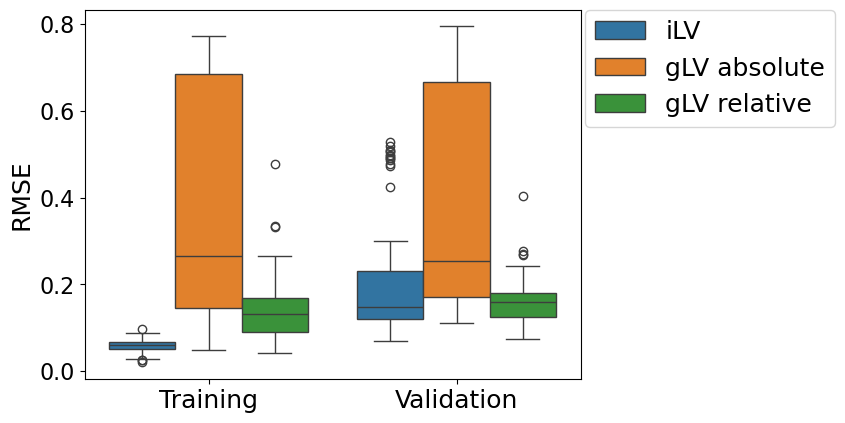

In [7]:
import seaborn as sns 
ax = sns.boxplot(x = data_plot['Type'], 
            y = data_plot['Value'], 
            hue = data_plot['Method'])

ax.tick_params(axis='x', labelsize=18)  # Change font size for x-axis tick labels
ax.tick_params(axis='y', labelsize=16)

ax.set_xlabel("", fontsize=18)                  # Set x-axis label and size
ax.set_ylabel("RMSE", fontsize=18)                         # Set y-axis label and size

# Adjust legend font size
legend = ax.legend(fontsize=18)
legend.set_title("Methods")                              # Set legend title
for text in legend.texts:
    text.set_fontsize(18) 

ax.legend(loc='upper left', bbox_to_anchor=(1.01, 1), borderaxespad=0, fontsize=18)

plt.savefig("culture_two_species_benchmark.jpg", dpi=300, bbox_inches="tight")


In [8]:
# Step 1: Perform the Friedman test
stat, p_value = friedmanchisquare(distance_ilv, distance_glva, distance_glvr)
print("Friedman test results:")
print(f"Statistic: {stat}, P-value: {p_value}")

# Step 2: Check significance of Friedman test
if p_value < 0.05:
    print("Significant differences detected. Proceeding with post-hoc pairwise comparisons...")

    # Step 3: Post-hoc pairwise comparisons using Wilcoxon signed-rank test
    pairwise_results = []
    comparisons = [
        ("distance_ilv", "distance_glva", distance_ilv, distance_glva),
        ("distance_ilv", "distance_glvr", distance_ilv, distance_glvr),
        ("distance_glva", "distance_glvr", distance_glva, distance_glvr)
    ]

    for name1, name2, group1, group2 in comparisons:
        stat, p = wilcoxon(group1, group2, alternative='less')  # Test for lower values
        pairwise_results.append((name1, name2, stat, p))

    # Step 4: Apply Bonferroni correction for multiple comparisons
    p_values = [result[3] for result in pairwise_results]
    corrected_p = multipletests(p_values, method="bonferroni")[1]

    # Step 5: Display results
    print("\nPairwise comparisons with Bonferroni correction:")
    for i, (name1, name2, stat, p) in enumerate(pairwise_results):
        print(f"{name1} vs {name2} -> Statistic: {stat}, Original P-value: {p}, Corrected P-value: {corrected_p[i]}")
else:
    print("No significant differences detected among the groups.")

Friedman test results:
Statistic: 175.92000000000007, P-value: 6.301694886178984e-39
Significant differences detected. Proceeding with post-hoc pairwise comparisons...

Pairwise comparisons with Bonferroni correction:
distance_ilv vs distance_glva -> Statistic: 0.0, Original P-value: 1.9481700188239655e-18, Corrected P-value: 5.8445100564718965e-18
distance_ilv vs distance_glvr -> Statistic: 0.0, Original P-value: 1.9481700188239655e-18, Corrected P-value: 5.8445100564718965e-18
distance_glva vs distance_glvr -> Statistic: 4801.0, Original P-value: 0.9999999999999974, Corrected P-value: 1.0


In [9]:
# Step 1: Perform the Friedman test
stat, p_value = friedmanchisquare(distance_ilv_val, distance_glva_val, distance_glvr_val)
print("Friedman test results:")
print(f"Statistic: {stat}, P-value: {p_value}")

# Step 2: Check significance of Friedman test
if p_value < 0.05:
    print("Significant differences detected. Proceeding with post-hoc pairwise comparisons...")

    # Step 3: Post-hoc pairwise comparisons using Wilcoxon signed-rank test
    pairwise_results = []
    comparisons = [
        ("distance_ilv_val", "distance_glva_val", distance_ilv_val, distance_glva_val),
        ("distance_ilv_val", "distance_glvr_val", distance_ilv_val, distance_glvr_val),
        ("distance_glva_val", "distance_glvr_val", distance_glva_val, distance_glvr_val)
    ]

    for name1, name2, group1, group2 in comparisons:
        stat, p = wilcoxon(group1, group2, alternative='less')  # Test for lower values
        pairwise_results.append((name1, name2, stat, p))

    # Step 4: Apply Bonferroni correction for multiple comparisons
    p_values = [result[3] for result in pairwise_results]
    corrected_p = multipletests(p_values, method="bonferroni")[1]

    # Step 5: Display results
    print("\nPairwise comparisons with Bonferroni correction:")
    for i, (name1, name2, stat, p) in enumerate(pairwise_results):
        print(f"{name1} vs {name2} -> Statistic: {stat}, Original P-value: {p}, Corrected P-value: {corrected_p[i]}")
else:
    print("No significant differences detected among the groups.")

Friedman test results:
Statistic: 72.25999999999999, P-value: 2.036762399152818e-16
Significant differences detected. Proceeding with post-hoc pairwise comparisons...

Pairwise comparisons with Bonferroni correction:
distance_ilv_val vs distance_glva_val -> Statistic: 637.0, Original P-value: 4.24754397372687e-11, Corrected P-value: 1.274263192118061e-10
distance_ilv_val vs distance_glvr_val -> Statistic: 3052.0, Original P-value: 0.9650067882897986, Corrected P-value: 1.0
distance_glva_val vs distance_glvr_val -> Statistic: 4773.0, Original P-value: 0.9999999999999946, Corrected P-value: 1.0
